In [1]:
from pathlib import Path
import os

from astropy.nddata import CCDData
from astropy.visualization import hist
from astropy.stats import mad_std

import ccdproc as ccdp
import matplotlib.pyplot as plt
import numpy as np
import sys
from astropy import units as u


sys.path.append("/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline")
import fpnfix
from aperturePhot import showimage as show_image

from astropy.io import fits
from astropy.wcs import WCS
from astropy.coordinates import SkyCoord
import aperturePhot as ap

In [2]:
path = "/home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/"
day = "20211115"
path_day = os.path.join(path, day)

data_red = Path(path_day, "Reduced_Images")
data_red.mkdir(exist_ok = True)

In [3]:
files = ccdp.ImageFileCollection(path_day)
files.summary['file', 'imagetyp', 'filter', 'exptime', 'naxis1', 'naxis2']

file,imagetyp,filter,exptime,naxis1,naxis2
str30,str11,object,float64,int64,int64
Ast2-001V.fit,Light Frame,Bessel V,60.0,1024,1024
Ast2-002V.fit,Light Frame,Bessel V,60.0,1024,1024
Asteroid3-001V.fit,Light Frame,Bessel V,60.0,1024,1024
Asteroid3-002V.fit,Light Frame,Bessel V,60.0,1024,1024
Asteroid3-003V.fit,Light Frame,Bessel V,60.0,1024,1024
Asteroid3-004V.fit,Light Frame,Bessel V,60.0,1024,1024
Bias-001.fit,Bias Frame,--,0.0,1024,1024
Bias-002.fit,Bias Frame,--,0.0,1024,1024
Bias-003.fit,Bias Frame,--,0.0,1024,1024


In [4]:
calibrated_biases = files.files_filtered(imagetyp='Bias Frame', include_path=True)

combined_bias = ccdp.combine(calibrated_biases,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit = "adu")

combined_bias.meta['combined'] = True

combined_bias.write(os.path.join(data_red / 'combined_bias.fit'), overwrite = True)

In [5]:
calibrated_darks = files.files_filtered(imagetyp='Dark Frame', include_path=True)
reduced_darks= []
exptime= []

for frame in calibrated_darks:
    image = ccdp.CCDData.read(frame, unit = 'adu')
    exptime.append(image.header["exposure"])
    reduced_darks.append(ccdp.subtract_bias(image, combined_bias))
    
combined_darks = ccdp.combine(reduced_darks,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit = "adu", scale =1 / np.array(exptime))

combined_darks.header["exposure"] = 1
combined_darks.header['exptime'] = 1

combined_darks.meta['combined'] = True

combined_darks.write(os.path.join(data_red / 'combined_darks.fit'), overwrite = True)

In [6]:
flat_imagetyp = 'Flat Field'

flat_filters = set(h['filter'] for h in files.headers(imagetyp=flat_imagetyp))
flat_filters

{'Bessel B', 'Bessel R', 'Bessel V'}

In [7]:
scale = lambda a: 1/np.median(a)

master_flats = {}

for filt in flat_filters:
    reduced_flats = []
    calibrated_flats = files.files_filtered(imagetyp = flat_imagetyp, filter = filt, include_path=True)
    
    for flat in calibrated_flats:
        image = ccdp.CCDData.read(flat, unit = "adu")
        image = ccdp.subtract_bias(image, combined_bias)
        image = ccdp.subtract_dark(image, combined_darks, scale=True, exposure_unit=u.s, exposure_time = "exptime")
        #image = fpnfix.subtract_fpn(image,combfpn[60],mesh_size=32, verbose = 2)
        reduced_flats.append(image)
    
    combined_flats = ccdp.combine(reduced_flats,
                                 method='median',
                                 sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                                 sigma_clip_func=np.ma.median, signma_clip_dev_func=mad_std, unit = "adu", scale = scale
                                )

    master_flats[filt]=combined_flats.copy()

    combined_flats.write(data_red / (filt.replace("","_")+"_combined_flats.fit"), overwrite = True)

804.6309676170349 2.2239
795.0 810.5


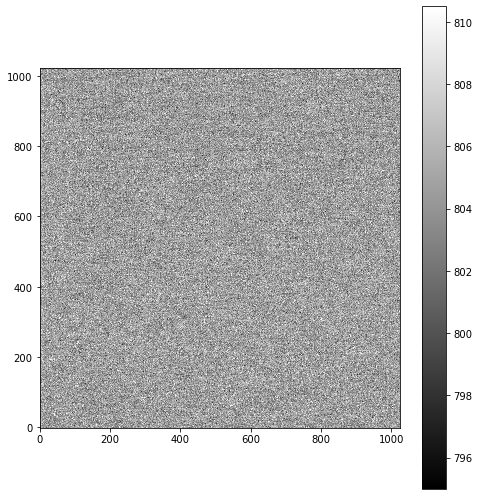

In [8]:
show_image(combined_bias)

0.04070663452148439 0.061775000000000004
-0.19166666666666665 0.4079106594638774


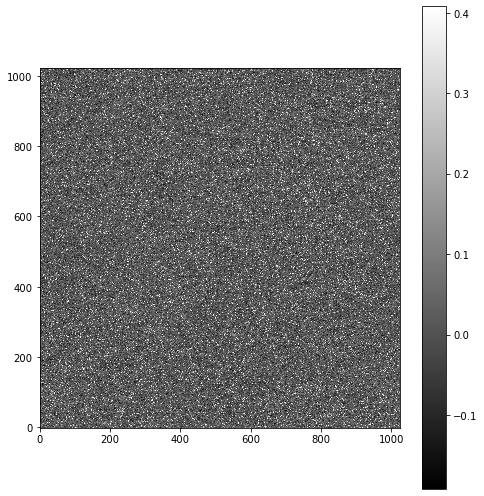

In [9]:
show_image(combined_darks)

0.9997765398614971 0.006286643109540614
0.9654416961130743 1.0173071489121222


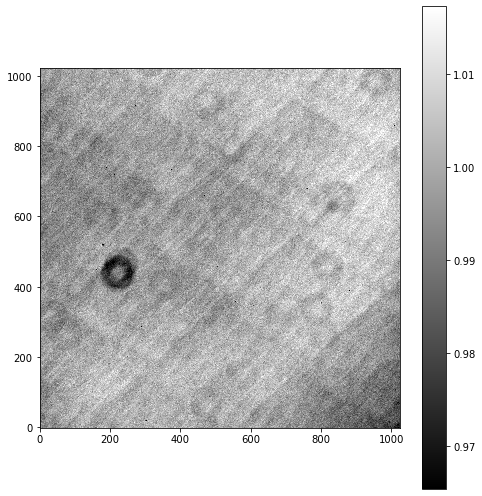

1.0011212188812226 0.006739207305364398
0.9697479230652782 1.0400151010460124


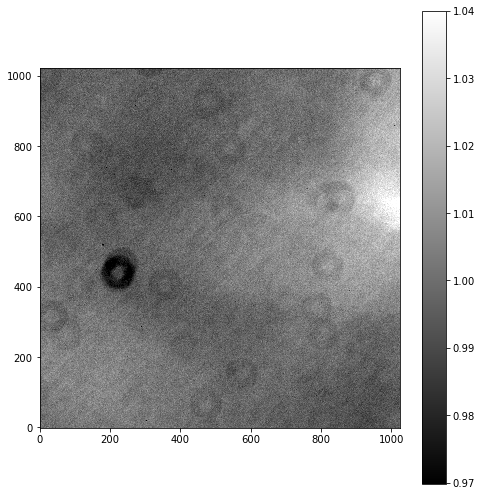

1.00010926637495 0.006093949008442604
0.9693748536642472 1.0256515791938285


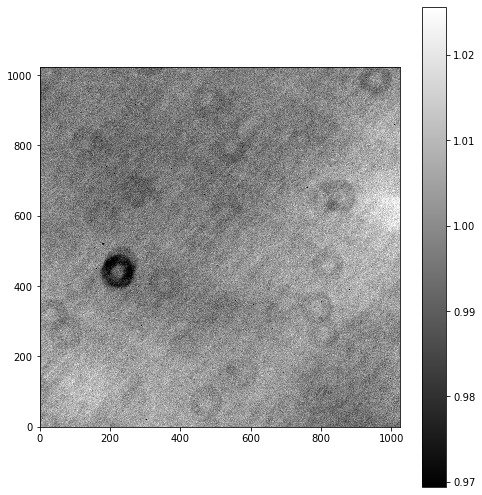

In [10]:
for filt,image in master_flats.items():
    show_image(image)

In [11]:
import ccdproc
images = files.files_filtered(imagetyp="Light Frame", include_path = True)

for image in images:
    var = ccdp.CCDData.read(image, unit = "adu")
    var_filt = var.header["filter"]
    
    corr_filt = master_flats[var_filt]
    
    var = ccdproc.ccd_process(var,
                             master_bias = combined_bias, dark_frame = combined_darks,
                             master_flat = corr_filt, exposure_key="exposure", exposure_unit = u.second,
                             dark_scale = True)
    proc_data = os.path.basename(image)
    var.write(data_red / ("BDF_"+proc_data), overwrite = True)

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
246.06871583897458 11.787286585714197
208.9308433035013 314.5434228931862


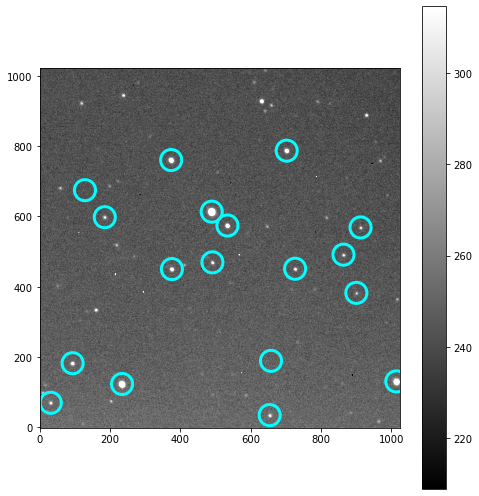

      xcentroid   ycentroid       mag
14   488.931963  613.743764 -4.046992
2    233.774974  123.436853 -3.240157
3   1014.164655  130.757908 -3.114671
16   373.532023  760.576946 -2.085941
17   702.211209  787.254366 -1.644635
12   533.664255  574.299174 -1.571815
7    375.671084  450.382244 -0.980328
9    490.891742  469.564710 -0.715902
4     93.176530  182.667205 -0.598007
13   184.679718  597.980982 -0.407658
10   863.814824  491.413047 -0.295682
15   128.298253  674.868349 -0.195319
8    726.180591  451.340515 -0.188293
1     30.972152   69.950874 -0.086881
0    653.803077   34.840772 -0.034734
5    657.615429  189.297822 -0.034079
11   912.389117  568.756188 -0.015736
6    900.400027  382.664304 -0.000377
Point RA 23 41 55
Point Dec +44 10 48
objcoord <SkyCoord (ICRS): (ra, dec) in deg
    (355.47916667, 44.18)>
radecstr 355.479 44.18
Search radius = 0.13106342470013851 deg
        ra                dec         phot_bp_mean_mag
       deg                deg               mag    

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


Return code: 0 


dxfit [3.80040299e+02 1.60987049e+00 2.11742167e-01]
dyfit [ 5.21775905e+02 -2.12091257e-01  1.60944221e+00]

scalex, scaley: 0.6158637644350519 0.6160075659151356
anglex, angley: -7.4929574998653194 -7.507144476424669
fracdiffs: 0.0018933747535073537 0.00023349560144306006

# Created by grmatch 0.9e0 (fi: 0.9.4)
# Invoked command: /home/idies/workspace/Storage/madisonleblanc/persistent/bin/grmatch -r /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211115/Reduced_Images/BDF_HH_And-001B.gaia.proj -i /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211115/Reduced_Images/BDF_HH_And-001B.stars.csv -o /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211115/Reduced_Images/BDF_HH_And-001B.match.csv --match-points --col-ref 4,5 --col-inp 2,3 --output-transformation /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211115/Reduced_Images/BDF_HH_And-001B.match.tran

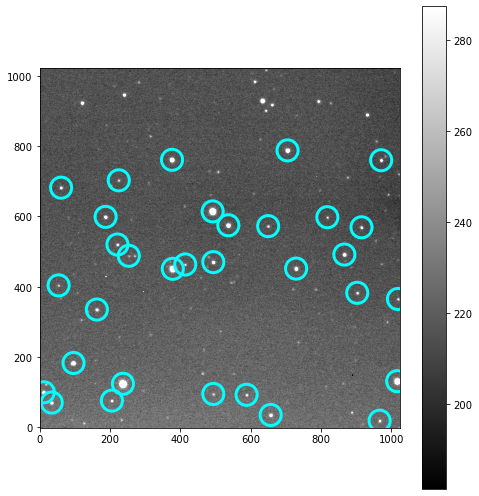

      xcentroid   ycentroid       mag
7    236.336757  124.021502 -5.161844
26   491.514132  614.464406 -4.754990
14   378.166380  451.122983 -4.530171
8   1016.711765  131.440641 -4.230619
30   375.971002  761.287669 -2.856204
23   536.171705  575.009257 -2.700672
31   704.701432  788.080211 -2.670210
9     95.776375  183.177537 -2.527594
15   729.052133  451.763280 -2.099290
19   866.298347  491.675702 -1.778816
25   187.039809  598.919617 -1.654450
6     11.126493   99.861247 -1.519592
17   493.429691  470.189552 -1.484993
1    656.667953   35.364332 -1.230490
2     33.712840   70.603259 -1.209153
10   162.209241  335.311637 -1.186775
29   970.996581  760.107544 -1.012640
21   915.140488  569.227131 -0.829217
12   902.948479  382.864072 -0.797280
27    60.390227  682.026242 -0.629000
3    204.946848   76.167128 -0.591939
4    588.140521   92.678670 -0.531669
11  1018.794681  365.308772 -0.491182
16   413.646088  463.564922 -0.464846
20   220.744062  520.259907 -0.428796
24   817.925

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


Return code: 0 


dxfit [3.82591157e+02 1.60986313e+00 2.11702430e-01]
dyfit [ 5.22453815e+02 -2.11881268e-01  1.60982306e+00]

scalex, scaley: 0.6158684959996789 0.6158747172323683
anglex, angley: -7.4916011257526955 -7.49804229141784
fracdiffs: 0.0008597849187408347 1.0101560202967392e-05

# Created by grmatch 0.9e0 (fi: 0.9.4)
# Invoked command: /home/idies/workspace/Storage/madisonleblanc/persistent/bin/grmatch -r /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211115/Reduced_Images/BDF_HH_And-001R.gaia.proj -i /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211115/Reduced_Images/BDF_HH_And-001R.stars.csv -o /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211115/Reduced_Images/BDF_HH_And-001R.match.csv --match-points --col-ref 4,5 --col-inp 2,3 --output-transformation /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211115/Reduced_Images/BDF_HH_And-001R.match.trans

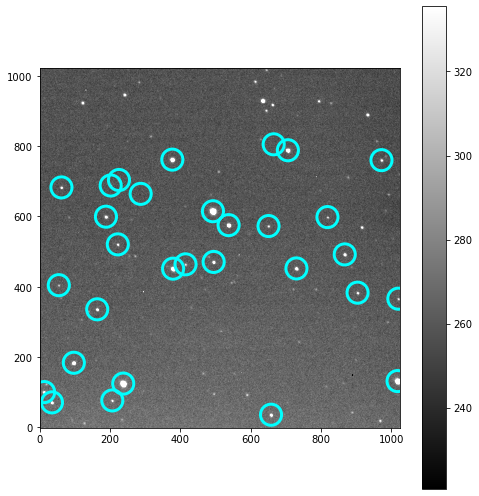

      xcentroid   ycentroid       mag
21   492.413437  614.967266 -4.891066
4    237.203518  124.636626 -4.739738
5   1017.621883  131.785173 -3.826052
11   379.013253  451.559811 -3.069378
27   376.798575  761.777048 -3.055680
18   536.966581  575.420510 -2.465384
28   705.620711  788.479803 -2.465138
6     96.642732  183.856264 -2.201584
20   187.976023  599.421506 -1.510921
14   494.459123  470.724031 -1.307969
12   729.978816  452.213363 -1.281884
1     34.410279   71.136420 -1.258371
15   867.347317  492.136144 -1.225092
3     12.047720  100.442910 -1.211214
7    163.171675  335.910109 -1.120427
23    61.346790  682.687057 -1.001731
0    657.685186   36.015418 -0.941145
26   971.870086  760.273457 -0.818996
16   221.733628  520.670082 -0.665299
25   225.006990  703.814056 -0.431053
2    206.066458   76.661834 -0.420709
9    903.812503  383.275951 -0.386656
24   201.426989  688.198897 -0.352358
13   414.459440  463.883078 -0.342422
17   650.579931  572.839618 -0.311006
10    53.830

/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:298: RuntimeWarning: divide by zero encountered in double_scalars
  scalex = 1.0/(dxfit[1]/np.cos(anglex))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:299: RuntimeWarning: divide by zero encountered in double_scalars
  scaley = 1.0/(dyfit[2]/np.cos(angley))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:301: RuntimeWarning: invalid value encountered in double_scalars
  fracanglediff = np.abs((anglex - angley)/anglex)
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:302: RuntimeWarning: invalid value encountered in double_scalars
  fracscalediff = np.abs((scalex-scaley)/scalex)


In [12]:
import plateSolve
pathlist = Path(data_red).glob('BDF_HH_And*.fit')

for path in pathlist:
    
    Rimage = ccdp.CCDData.read(path, unit="adu")
    
    check = plateSolve.autoSolve(path,Rimage, verbose = 1)
    if (check == True):
        #print(check)
        print(Rimage.header['JD-HELIO'])
        print("______________________________________________")
        
    else:
        print("!!!!!!!Plate solve did not work for", path)
        print("______________________________________________")
        print(" ")

['id', 'xcentroid', 'ycentroid', 'sharpness', 'roundness1', 'roundness2', 'npix', 'sky', 'peak', 'flux', 'mag']
Star magnitudes at reference aperture radius (4.5):
9 -8.450982118152536
0 -7.604771549616329
1 -7.478272072251819
11 -6.487854331230788
12 -5.969171728234535


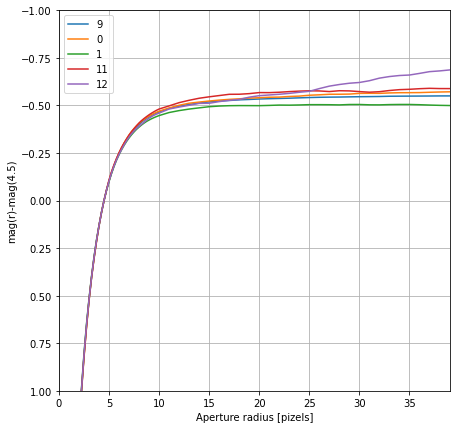

Optimum aperture:
9 7.75
0 6.75
1 6.5
11 5.5
12 5.25
7 5.25
14 5.0
3 5.25
2 4.5


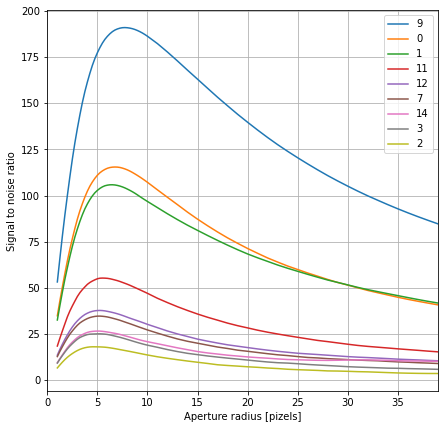

Mean optimum aperture radius = 4.75 from stars [14, 2]
Optimum aperture radius 4.75
stoppingidx 52 26.0
Systematic error from r>stopping aperture
Aperture correction: -0.45019272845222247 +/- 0.0016543845254459422
   0  -8.110 +/- 0.008 (stat) 0.002 (sys)
   1  -7.982 +/- 0.009 (stat) 0.002 (sys)
   2  -5.546 +/- 0.051 (stat) 0.002 (sys)
   3  -5.947 +/- 0.037 (stat) 0.002 (sys)
   4  -5.052 +/- 0.077 (stat) 0.002 (sys)
   5  -5.139 +/- 0.072 (stat) 0.002 (sys)
   6  -4.790 +/- 0.097 (stat) 0.002 (sys)
   7  -6.364 +/- 0.027 (stat) 0.002 (sys)
   8  -4.937 +/- 0.085 (stat) 0.002 (sys)
   9  -8.956 +/- 0.005 (stat) 0.002 (sys)
  10  -0.026 +/- 7.286 (stat) 0.002 (sys)
  11  -6.994 +/- 0.017 (stat) 0.002 (sys)
  12  -6.474 +/- 0.025 (stat) 0.002 (sys)
  13  -5.070 +/- 0.075 (stat) 0.002 (sys)
  14  -6.015 +/- 0.035 (stat) 0.002 (sys)
  15     nan +/- -1.755 (stat) 0.002 (sys)
246.06871583897458 11.787286585714197
208.9308433035013 314.5434228931862
['0', '1', '2', '3', '4', '5', '6', '7'

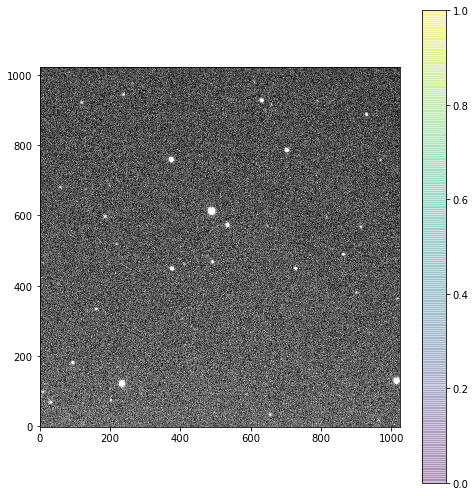

60.0
1.03062621536526


In [3]:
import warnings 

warnings.simplefilter("ignore")
os.chdir(Path(data_red))
#imR = CCDData.read("BDF_HHAnd_0000_002R.wcs.fit", unit = "adu")
imR = fits.open('BDF_HH_And-001B.wcs.fit')

#Find stars in the image
sources, bgplane= ap.findStars(imR)

#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rap,mag,err,apers = ap.growthCurve(imR,sources)

#Plot the growth curve - use this to pick stars to use when calculating 
#the aperture correction
ap.plotGrowth(rap,mag,err,figsize=(7,7))
useForAppCorr = [1]
stoppingApertureRadius = 26.0

#Plot the SNR curve for a chosen star(s) and estimate the optimum aperture
ap.plotSNR(rap,mag,err,Nbrightest=9,figsize=(7,7))

#Apply an aperture correction for a chosen optimal aperture radius
imag,ierr,isys,apCorr = ap.apertureCorrection(rap,mag,err,optap=[14,2],
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)


for i,m in enumerate(imag):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

imag
ap.showimage(imR[0].data,stars=sources)
print(imR[0].header['EXPOSURE'])
print(imR[0].header["AIRMASS"])

In [4]:
xpix = sources["xcentroid"][3]
ypix = sources["ycentroid"][3]
w = WCS(imR[0].header)
xpixe = sources["xcentroid"][3]-0.0344549 
ypixe= sources["ycentroid"][3]-0.0344549 
sky =w.pixel_to_world(xpix,ypix)
err = w.pixel_to_world(xpixe,ypixe)
print(sky)
print(err)

<SkyCoord (ICRS): (ra, dec) in deg
    (355.48029056, 44.16788631)>
<SkyCoord (ICRS): (ra, dec) in deg
    (355.48028349, 44.1678797)>


['id', 'xcentroid', 'ycentroid', 'sharpness', 'roundness1', 'roundness2', 'npix', 'sky', 'peak', 'flux', 'mag']
Star magnitudes at reference aperture radius (4.0):
6 -10.065750518352125
23 -9.66475143256159
12 -9.320104980644087
7 -9.13789576412719
27 -7.772268202132807


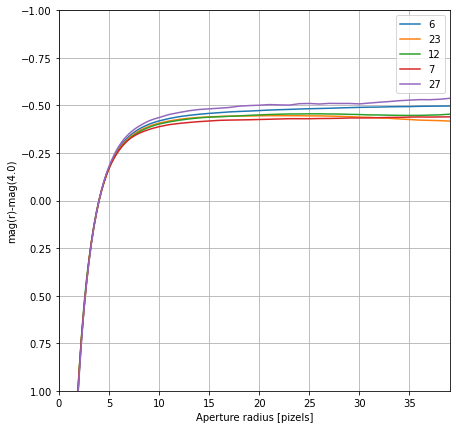

Optimum aperture:
6 7.5
23 7.0
12 6.5
7 6.0
27 5.0
34 5.0
28 4.75
20 4.75
8 4.75


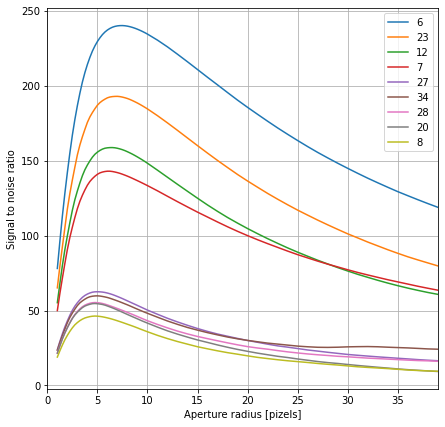

Mean optimum aperture radius = 4.75 from stars [28, 20]
Optimum aperture radius 4.75
stoppingidx 52 26.0
Systematic error from r>stopping aperture
Aperture correction: -0.29680266437208225 +/- 0.0029327863183818987
   0  -5.899 +/- 0.088 (stat) 0.003 (sys)
   1  -6.711 +/- 0.045 (stat) 0.003 (sys)
   2  -6.542 +/- 0.052 (stat) 0.003 (sys)
   3  -5.946 +/- 0.085 (stat) 0.003 (sys)
   4  -5.737 +/- 0.102 (stat) 0.003 (sys)
   5  -6.848 +/- 0.040 (stat) 0.003 (sys)
   6 -10.503 +/- 0.004 (stat) 0.003 (sys)
   7  -9.569 +/- 0.007 (stat) 0.003 (sys)
   8  -7.783 +/- 0.020 (stat) 0.003 (sys)
   9  -6.487 +/- 0.054 (stat) 0.003 (sys)
  10  -5.616 +/- 0.112 (stat) 0.003 (sys)
  11  -5.942 +/- 0.085 (stat) 0.003 (sys)
  12  -9.754 +/- 0.006 (stat) 0.003 (sys)
  13  -7.342 +/- 0.027 (stat) 0.003 (sys)
  14  -5.459 +/- 0.129 (stat) 0.003 (sys)
  15  -6.847 +/- 0.040 (stat) 0.003 (sys)
  16  -7.112 +/- 0.032 (stat) 0.003 (sys)
  17  -5.993 +/- 0.081 (stat) 0.003 (sys)
  18  -6.174 +/- 0.069 (stat)

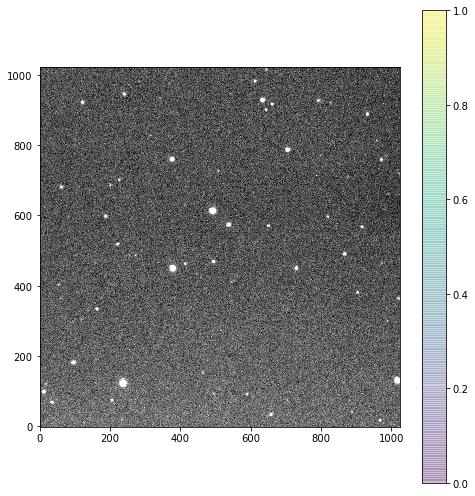

20.0
1.03058225871322


In [5]:
os.chdir(Path(data_red))
#imR = CCDData.read("BDF_HHAnd_0000_002R.wcs.fit", unit = "adu")
imR = fits.open('BDF_HH_And-001R.wcs.fit')

#Find stars in the image
sources, bgplane= ap.findStars(imR)

#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rap,mag,err,apers = ap.growthCurve(imR,sources)

#Plot the growth curve - use this to pick stars to use when calculating 
#the aperture correction
ap.plotGrowth(rap,mag,err,figsize=(7,7))
useForAppCorr = [7]
stoppingApertureRadius = 26.0

#Plot the SNR curve for a chosen star(s) and estimate the optimum aperture
ap.plotSNR(rap,mag,err,Nbrightest=9,figsize=(7,7))

#Apply an aperture correction for a chosen optimal aperture radius
imag,ierr,isys,apCorr = ap.apertureCorrection(rap,mag,err,optap=[28,20],
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)

for i,m in enumerate(imag):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

imag
ap.showimage(imR[0].data,stars=sources)
print(imR[0].header['EXPOSURE'])
print(imR[0].header["AIRMASS"])

In [6]:
xpix = sources["xcentroid"][12]
ypix = sources["ycentroid"][12]
w = WCS(imR[0].header)
xpixe = sources["xcentroid"][12]-0.0439377 
ypixe= sources["ycentroid"][12]-0.0439377

sky =w.pixel_to_world(xpix,ypix)
err = w.pixel_to_world(xpixe,ypixe)
print(sky)
print(err)

<SkyCoord (ICRS): (ra, dec) in deg
    (355.48027454, 44.16789831)>
<SkyCoord (ICRS): (ra, dec) in deg
    (355.48026552, 44.16788988)>
